## 3 Network Visualisation :

Every layer in a deep neural network takes an input and converts them in to an alternate representation. To accomplish this, these networks have to learn  a huge set of parameters also called as weights. In this module, our focus is on trying to intepret the information contained in these models, through visualising those parameters and also by manipulating the internal states of those hidden layers. 

## 3.1 Intermediate feature visualisation:

By construction, we are aware that the convolutional neural networks contain numerous filters, whose values are learned during training. Once a model is trained, the parameters of the model are stored for future use and is refered to as model in most deep learning framework. By visualising these parameters we could get an idea of what these filters are and what they are looking for in their input. For a hand crafted filter , like Sobel, we know that they are looking for edges and through this exercise we are trying to check if the filters inside a deep network has some meaningful correlation.

## 3.1.1 VGG 16:

VGG16 is a stack  of multiple 3*3 filters placed on top of each other. It was proposed by K. Simonyan and A. Zisserman in the paper “Very Deep Convolutional Networks for Large-Scale Image Recognition”. It improved upon the pathbreaking AlexNet architecture on the ImageNet challenge in 2014. Though it is an older archictecture and no longer the state of art, the simplicity of the network design makes it a good model for illustrating various network behaviour. There are multiple variants of it and we are looking at VGG16,where 16 refers to the number of hidden layers.


<img src = "../images/vgg16.png">

We will load a pretrained model provided with keras and have a look at the architecture.

In [1]:

# Reference

## Load matplotlib for plots and tensorflow our main workhorse
import matplotlib.pyplot as plot
%matplotlib inline

#requires a stable version of tensorflow 1.14
import tensorflow as tf

In [2]:
## Keras provides free trained models for popular architecture ,lets pick VGG16 
VGG16 = tf.keras.applications.VGG16()

W1107 20:22:05.907984 139678969603904 deprecation.py:506] From /home/peerless/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


In [3]:
##TASK

## Use appropriate Keras API to produce a summary of VGG16 model describing each layer.

## Summary displays the structure of input and output of a layer along with the number of parameters in the layer.

VGG16.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [4]:
## Note the summary doesnt tell us about the structure of filters directly, lets discover that by exploring
## each of the layers in the model.
model = VGG16

for layer in model.layers:
    if 'conv' not in layer.name:
        continue
    filters,biases = layer.get_weights()
    print(layer.name,filters.shape)

block1_conv1 (3, 3, 3, 64)
block1_conv2 (3, 3, 64, 64)
block2_conv1 (3, 3, 64, 128)
block2_conv2 (3, 3, 128, 128)
block3_conv1 (3, 3, 128, 256)
block3_conv2 (3, 3, 256, 256)
block3_conv3 (3, 3, 256, 256)
block4_conv1 (3, 3, 256, 512)
block4_conv2 (3, 3, 512, 512)
block4_conv3 (3, 3, 512, 512)
block5_conv1 (3, 3, 512, 512)
block5_conv2 (3, 3, 512, 512)
block5_conv3 (3, 3, 512, 512)


The first three dimensions represent the filter shape (width,height , depth) and the final dimension represents the number of filters. For examples block3_conv2 contains 128 filters of shape 3 * 3 * 128 .

## 3.1.2 Visualising Filters:

We could see that the model is composed of 3 * 3 filters of dimensions 3 * 3 * $n_i$ arranged sequentially one after another -  $n_i$ refers to the number of channels/dimensions in the input to that channel.For first layer, the input is the image and hence n=3. Whereas for block5_conv3, the input from previous layer has 512 channels , hence the filter size is 3 * 3 * 512.<br> 
 
 Each layer contains multiple filters of this shape. Let us pick few of those and visualise it.


In [5]:
## Reference:
## Visualising filters from first layer:

## Get the weights and biases from first layer.


filters, biases = model.layers[1].get_weights()

In [6]:
print(filters.shape)

(3, 3, 3, 64)


Each of those filters is 3*3*3 in size and there are 64 of them.

In [7]:
#Normalise the filter to be 0-1 range for better visualisation

f_min, f_max = filters.min(), filters.max()
filters = (filters - f_min) / (f_max - f_min)

In [8]:

## Helper routine to plot filters
def plot_filters(num_rows,num_cols,filters):
    index =1
    for i in range(num_rows):
        f = filters[:,:,i]
        for j in range(num_cols):
            ax = plot.subplot(num_cols,num_rows,index)
            ax.imshow(f[:,:,j],cmap='gray')
            ax.set_xticks([])
            ax.set_yticks([])
            index+=1
    plot.show()

In [9]:
filters.shape

(3, 3, 3, 64)

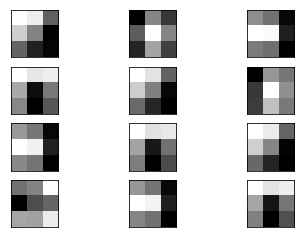

In [10]:
## There are 64 filters, but lets visualise the first four of them
## Num_filters refers to the number of filters we are visualising. Each row is a filter.
## index is to track the plots, each filter has three channels corresponding to columns

num_rows,num_cols = 4,3
plot_filters(num_cols,num_rows,filters)

We have visualisated filters from first layer and they seem to be alternating dark and bright patches. This indicates they are looking for intensity differences, capturing edges in the image. We should look at the feature map to verify this hypothesis.

## 3.1.3 Visualising feature maps:


At each layer the input is transformed to an alternate representation. Visualising these internal representation can give us some cues on what transformations are applied to the image.

In [11]:
## Reference
## Let us look the shape of each output layer

for i,layer in enumerate(model.layers):
    if 'conv' not in layer.name:
        continue
    
    print(i,layer.name,layer.output.shape)

1 block1_conv1 (?, 224, 224, 64)
2 block1_conv2 (?, 224, 224, 64)
4 block2_conv1 (?, 112, 112, 128)
5 block2_conv2 (?, 112, 112, 128)
7 block3_conv1 (?, 56, 56, 256)
8 block3_conv2 (?, 56, 56, 256)
9 block3_conv3 (?, 56, 56, 256)
11 block4_conv1 (?, 28, 28, 512)
12 block4_conv2 (?, 28, 28, 512)
13 block4_conv3 (?, 28, 28, 512)
15 block5_conv1 (?, 14, 14, 512)
16 block5_conv2 (?, 14, 14, 512)
17 block5_conv3 (?, 14, 14, 512)


In [12]:
## Load a pre-trained model and examine intermediate activations.

from tensorflow.keras.preprocessing.image import load_img,img_to_array
from tensorflow.keras import Model

from tensorflow.keras.applications.vgg16 import preprocess_input
from numpy import expand_dims


In [13]:
model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

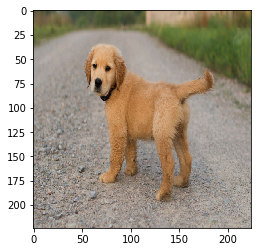

In [14]:
## Load an image 
img = load_img('../images/dog_1.jpg', target_size=(224, 224))

plot.imshow(img)

In [15]:
##Preprocess the image as required by a keras model
img = img_to_array(img)
img = expand_dims(img, axis=0)
img = preprocess_input(img)

In [16]:

## Create a new keras model, the output in this model refers to the layer 1 output instead of the network final output
activations_model = Model(inputs=model.inputs, outputs=model.layers[1].output)
activations_model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 1,792
Non-trainable params: 0
_________________________________________________________________


In [17]:
## We now have a model which returns layer1 output on predict.
feature_maps = activations_model.predict(img)


In [18]:
feature_maps.shape

(1, 224, 224, 64)

In [19]:
def plot_feature_maps(num_cols,num_rows,feature_map):

    num_features = 64
    num_columns,num_rows = 8,8
    plot_index =1
    for i in range(num_columns):
        for j in range(num_rows):
            ax = plot.subplot(num_rows,num_columns,plot_index)
            plot.imshow(feature_map[0,:,:,plot_index-1],cmap='gray')
            ax.set_xticks([])
            ax.set_yticks([])
            plot_index+=1
    plot.show()

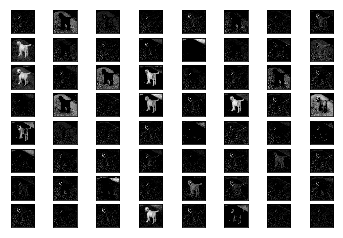

In [20]:
num_features = 64
num_cols,num_rows = 8,8
plot_index =1
num_cols ,num_rows = 8,8

plot_feature_maps(num_cols,num_rows,feature_maps)

The first layers typically look for edge-like features, hence you could see that the original shape of the image is preserved in most of the outputs from first layer activations.

In [21]:
## the shape matches with the output shape of layer 1.
feature_maps.shape

(1, 224, 224, 64)

Layer 5 feature maps produce are of dimension 224 * 224 * 64. This also indicates that there are 64 filters in layer5. The final dimension(depth) corresponds to the number of feature maps.  The first dimension corresponds to the batch size. The height and width depends on the filter size.

In [22]:
## Exercise

## Load VGG16 model and visualise filters from layer 5
## Report the size of the feature map 


import tensorflow as tf


model = tf.keras.applications.VGG16() ## Loads VGG 16 model  
activations_model = Model(inputs=model.inputs, outputs=model.layers[5].output) ## Set up the output to point to layer 5
activations_model.summary()


Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
Total params: 260,160
Trainable params: 260,160
Non-trainable params: 0
_____________________________________________________

In [23]:
# Model prediction now corresponds to layer 5 activations
feature_maps = activations_model.predict(img)
feature_maps.shape

(1, 112, 112, 128)

Layer 5 feature maps produce are of dimension 112 * 112 * 128. This also indicates that there are 128 filters in layer5. The final dimension(depth) corresponds to the number of feature maps.  The first dimension corresponds to the batch size. The height and width depends on the filter size.

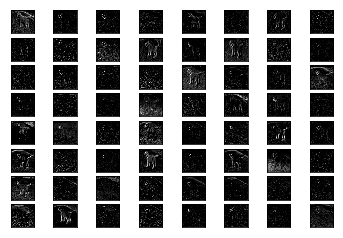

In [24]:
num_features = 64
num_cols,num_rows = 8,8
plot_index =1

plot_feature_maps(num_cols,num_rows,feature_maps)

In deeper layers the representations are less intepretable.

In [25]:
## Reference

## Now lets visualise a later layer, say 17


activations_model = Model(inputs=model.inputs, outputs=model.layers[17].output)
activations_model.summary()


Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0   

In [26]:

feature_maps = activations_model.predict(img)
feature_maps.shape

(1, 14, 14, 512)

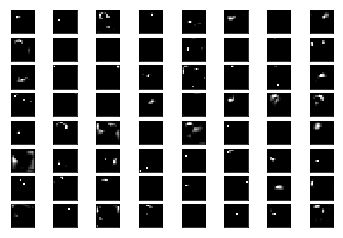

In [27]:
num_features = 64
num_cols,num_rows = 8,8
plot_index =1

plot_feature_maps(num_cols,num_rows,feature_maps)

Visualisation from early layer (layer 1) retains most of the information from image and is intepretable for human vision. Mostly it learns edges on the image, hence the structure in the input is preserved in layer 1 output. But as we move deeper, these representations becomes more abstract and we are not able to intepret anything from the visualisation. But these internal units, should be learning something meaningful , since the final prediction is dependent on it. In the next section we explore methods that help us explore what  these internal units are looking for.

## 3.2.1 Visualisation through activation maximisation:

In previous section, we passed an input and visualised the filters and intermediate activations. That gave us some insight on what the model is looking for.  When we train a neural network with millions of images, the model tries to capture the pattern in them by finding appropriate value for its parameters. The information in a huge dataset,in a way is now compressed within the model and stored in it's parameters.In this section we look at techniques that formulate  optimisation problems that help us get an understanding of such information that is contained within a model.


We know that each layer of a network takes an input and finds an alternate representation. We have seen that early layers equate to low level transformations like edge detections and later layers have representations that can reveal the presence/absence of certain object parts. The final layer is a special case where presence or absence of an object is notified.  <br>


When we feed an input and let it pass through the neural network, all these internal representations are computed to arrive at the final output. More specifically during training when we are aware of the output, we modify the parameters of the network until the network produces output closer to the actual output. Note that in this process we are distilling the information from the training dataset in to the network by selecting appropriate parameters.<br>


Now we invert this process, pick an output we desire and modify a random  input until we get our desired output, keeping the learned parameters intact. This helps us produce the input, that would result in the desired output.Note that in this process we are distilling the information present in the network ie, parameters of the network in to the input image.

In other words, we pick any neuron/channel/layer and set its activation to one while keeping rest of the activations to zero. We then use the usual gradient descent based optimisation strategies to modify the input, while keeping everything else unchanged in the network. We start with a random input and continue till we get the desired activation. This results in images that give us some insights on what the network is looking for.

## 3.2.2 Setting up the optimisation problem:

We are intepreting  a Deep Neural Network by visualizing the **information** stored in its **encodings or representations** at different levels like **neurons, channels and layers**.<br> 

In order to visualize what information is stored in the encodings, we construct or optimize a random input image such that to maximize the activations of a neuron, a channel or a layer and below we illustrate how it has been set as an optimisation problem.

**Maximizing Activations:**<br><br>
Let $\theta$ denote the neural network parameters (weights and biases) and let $h_{ij}(\theta,x)$ be the activation of the channel i and layer j in the network and $x$ be a random input image <br><br>
Then our objective function is: <br><br>
$x^* = arg \; max_{x\; s.t.\; ||x|| = \rho}\; h_{ij}(\theta,x)$<br><br>
where $\theta$ is fixed and we try to optimize the input image $x$ to maximize the activation $h_{ij}(\theta,x)$<br>

This can be done most easily by performing simple gradient ascent in the input space, i.e. computing the gradient of $h_{ij}(\theta,x)$ and moving x in the direction of this gradient. In plain english, vary the input until you get the desired $h_{ij}(\theta,x)$.

## Examples:
We will be looking at **Inception V1** model that has achieved state of the art accuracy in classification and detection in ILSVRC14 competition. We are making use of a tensorflow based visualisation library lucid.

In [28]:
# Reference

## Import the necessary modules.
import tensorflow as tf
import lucid.modelzoo.vision_models as models
import lucid.optvis.objectives as objectives
import lucid.optvis.render as render
from lucid.misc.io import show
import lucid.optvis.param as param

In [29]:
# importing InceptionV1 model that has been trained on ImageNet Data
model = models.InceptionV1_slim() 
model.load_graphdef()
model.layers

[Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Conv2d_1a_7x7/Relu: 64> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Conv2d_2b_1x1/Relu: 64> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Conv2d_2c_3x3/Relu: 192> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_3b/concat: 256> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_3c/concat: 480> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4b/concat: 512> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4c/concat: 512> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4d/concat: 512> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4e/concat: 528> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4f/concat: 832> ([{'con

### 3.2.3 Visualisation through Lucid:

Let us pick our  target  $h_{ij}$ by specifying the layer and a channel, and  start with a random input. We have loaded the inception graph and by picking a channel in make_vis function we have specified our optimisation objective. Lets run the optimisation for several iterations and observe how the input starts to show patterns that resemble the training data in imagenet dataset.

In [30]:
# we will be optimizing the input for the follwing objective layer:channel 
layer_channel = "InceptionV1/InceptionV1/Mixed_4b/concat:250" # layer:channel

W1107 20:22:16.841426 139678969603904 deprecation_wrapper.py:119] From /home/peerless/anaconda3/lib/python3.7/site-packages/lucid-0.3.9-py3.7.egg/lucid/optvis/param/spatial.py:85: The name tf.spectral.irfft2d is deprecated. Please use tf.signal.irfft2d instead.

W1107 20:22:16.851872 139678969603904 deprecation_wrapper.py:119] From /home/peerless/anaconda3/lib/python3.7/site-packages/lucid-0.3.9-py3.7.egg/lucid/optvis/render.py:223: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W1107 20:22:16.852365 139678969603904 deprecation_wrapper.py:119] From /home/peerless/anaconda3/lib/python3.7/site-packages/lucid-0.3.9-py3.7.egg/lucid/optvis/render.py:241: The name tf.train.AdamOptimizer is deprecated. Please use tf.compat.v1.train.AdamOptimizer instead.

W1107 20:22:16.852708 139678969603904 deprecation_wrapper.py:119] From /home/peerless/anaconda3/lib/python3.7/site-packages/lucid-0.3.9-py3.7.egg/lucid/optvis/render.py:169: The name tf.train

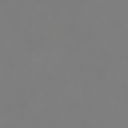

Step 0, Loss 0.707882821559906
0.5171039


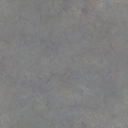

Step 1, Loss 0.9297358989715576
0.79991317


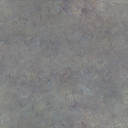

Step 2, Loss 0.8824682831764221
0.82788277


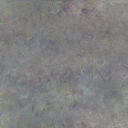

Step 3, Loss 1.0422114133834839
0.9820628


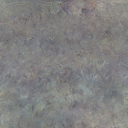

Step 4, Loss 1.0921449661254883
1.0859783


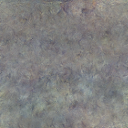

Step 5, Loss 1.373356819152832
1.3041296


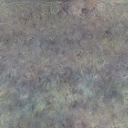

Step 6, Loss 1.3092249631881714
1.4626608


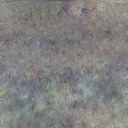

Step 7, Loss 1.231020450592041
1.1366216


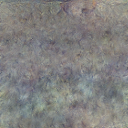

Step 8, Loss 1.4183961153030396
1.1988366


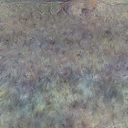

Step 9, Loss 1.3454126119613647
1.3510896


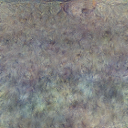

Step 10, Loss 1.5139610767364502
1.4882399


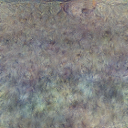

Step 11, Loss 1.6646814346313477
1.6806233


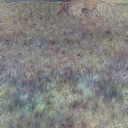

Step 12, Loss 1.5337916612625122
1.3386688


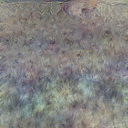

Step 13, Loss 1.434312343597412
1.4979686


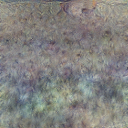

Step 14, Loss 1.645665168762207
1.6042778


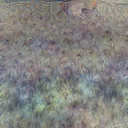

Step 15, Loss 1.6104356050491333
1.6931405


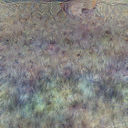

Step 16, Loss 1.9472343921661377
1.5248823


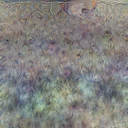

Step 17, Loss 1.8716304302215576
1.7869629


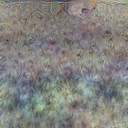

Step 18, Loss 1.9550336599349976
1.6609602


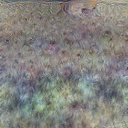

Step 19, Loss 1.9837005138397217
1.8697234


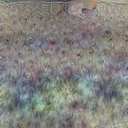

Step 20, Loss 1.9679031372070312
1.9340283


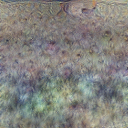

Step 21, Loss 1.662692666053772
1.9381194


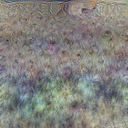

Step 22, Loss 1.9423916339874268
2.0374832


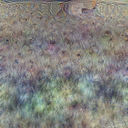

Step 23, Loss 2.007568120956421
1.7619967


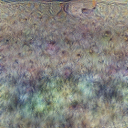

Step 24, Loss 2.0111474990844727
1.8581426


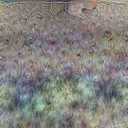

Step 25, Loss 1.6724392175674438
1.7229469


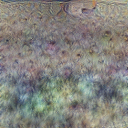

Step 26, Loss 1.7513576745986938
2.3228314


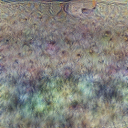

Step 27, Loss 2.108194589614868
2.2326882


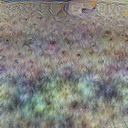

Step 28, Loss 1.7353522777557373
2.1712666


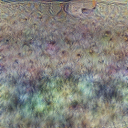

Step 29, Loss 2.3220105171203613
1.7823539


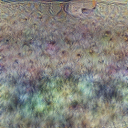

Step 30, Loss 1.9323570728302002
1.9932764


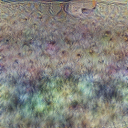

Step 31, Loss 1.825325608253479
2.351183


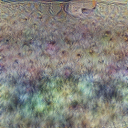

Step 32, Loss 2.0734598636627197
1.8500911


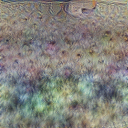

Step 33, Loss 2.1498324871063232
2.2774642


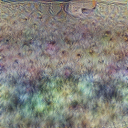

Step 34, Loss 1.920202374458313
1.9405307


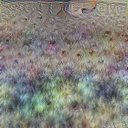

Step 35, Loss 1.7730258703231812
2.045838


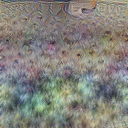

Step 36, Loss 1.9671026468276978
2.0493717


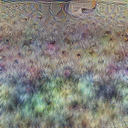

Step 37, Loss 1.9237184524536133
2.0202267


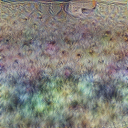

Step 38, Loss 2.2993147373199463
2.0769856


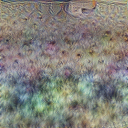

Step 39, Loss 2.0329458713531494
2.331642


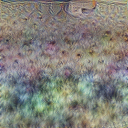

Step 40, Loss 2.21746563911438
2.4555275


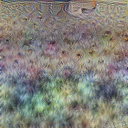

Step 41, Loss 1.8880259990692139
2.2430918


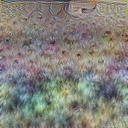

Step 42, Loss 2.329446315765381
1.8903345


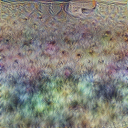

Step 43, Loss 2.148087978363037
2.1722796


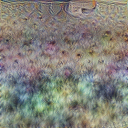

Step 44, Loss 2.357706069946289
2.1143875


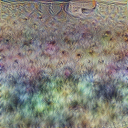

Step 45, Loss 2.0751988887786865
2.3444316


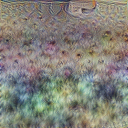

Step 46, Loss 2.505805253982544
2.110219


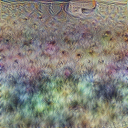

Step 47, Loss 2.5027272701263428
2.1161556


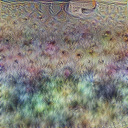

Step 48, Loss 2.2976183891296387
2.17672


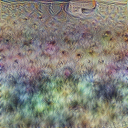

Step 49, Loss 2.058936834335327
2.6946769


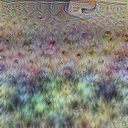

Step 50, Loss 2.3978168964385986
2.1580257


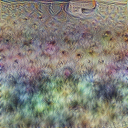

Step 51, Loss 2.25409197807312
2.1287801


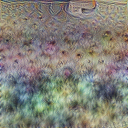

Step 52, Loss 2.505446672439575
2.5676138


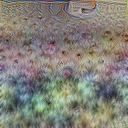

Step 53, Loss 2.2936670780181885
2.389914


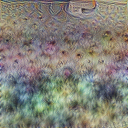

Step 54, Loss 2.7900948524475098
2.5703423


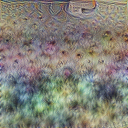

Step 55, Loss 2.4586644172668457
2.2520702


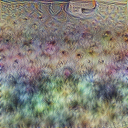

Step 56, Loss 2.547227382659912
2.3163557


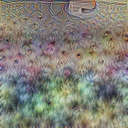

Step 57, Loss 2.300138235092163
2.2461858


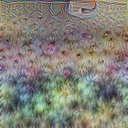

Step 58, Loss 2.4043567180633545
2.4686372


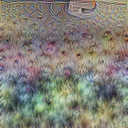

Step 59, Loss 2.5107486248016357
2.6369941


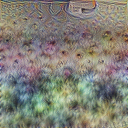

Step 60, Loss 2.204653263092041
2.4651372


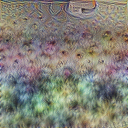

Step 61, Loss 2.348517656326294
2.177654


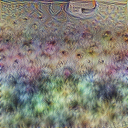

Step 62, Loss 2.1025290489196777
2.6597116


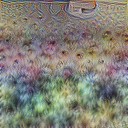

Step 63, Loss 2.217266798019409
2.680711


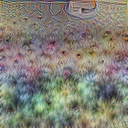

Step 64, Loss 2.1996071338653564
2.5308459


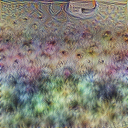

Step 65, Loss 2.495941638946533
2.4146857


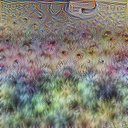

Step 66, Loss 2.266324520111084
2.3316238


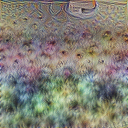

Step 67, Loss 2.8310556411743164
2.3625703


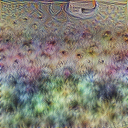

Step 68, Loss 2.662198305130005
2.8287683


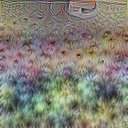

Step 69, Loss 2.515388250350952
2.703903


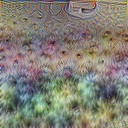

Step 70, Loss 2.7020065784454346
2.693283


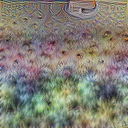

Step 71, Loss 2.599529981613159
2.6025214


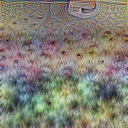

Step 72, Loss 2.679908037185669
2.4531147


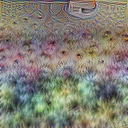

Step 73, Loss 2.556328058242798
2.5276086


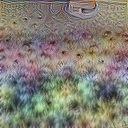

Step 74, Loss 2.714383840560913
2.2708492


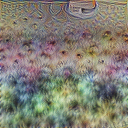

Step 75, Loss 2.600429058074951
2.5728326


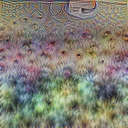

Step 76, Loss 2.4260668754577637
2.3328667


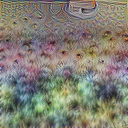

Step 77, Loss 2.6092770099639893
2.3157983


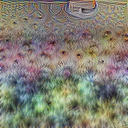

Step 78, Loss 2.5759949684143066
2.712859


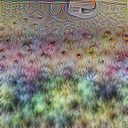

Step 79, Loss 2.4030873775482178
2.383596


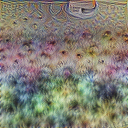

Step 80, Loss 2.9407782554626465
2.292814


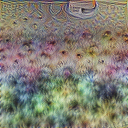

Step 81, Loss 2.4487318992614746
2.7061868


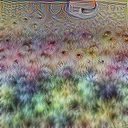

Step 82, Loss 2.5847508907318115
2.6652167


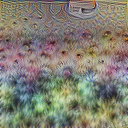

Step 83, Loss 2.45175838470459
2.737223


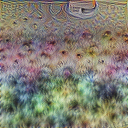

Step 84, Loss 2.7919745445251465
3.061385


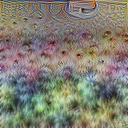

Step 85, Loss 2.8017935752868652
2.3129478


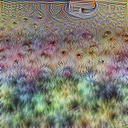

Step 86, Loss 2.783745527267456
3.0815868


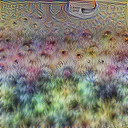

Step 87, Loss 2.324737787246704
2.6726437


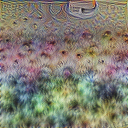

Step 88, Loss 2.359786033630371
2.7329862


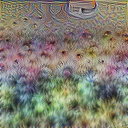

Step 89, Loss 2.7230477333068848
2.651809


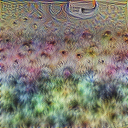

Step 90, Loss 2.4912705421447754
2.4054549


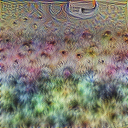

Step 91, Loss 2.2314271926879883
2.8104823


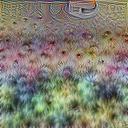

Step 92, Loss 2.5220046043395996
2.490079


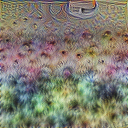

Step 93, Loss 2.823760986328125
2.4580112


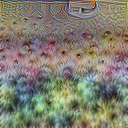

Step 94, Loss 2.6663973331451416
3.2152486


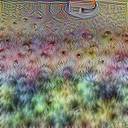

Step 95, Loss 2.962752342224121
2.9354355


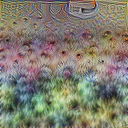

Step 96, Loss 2.5093424320220947
2.702321


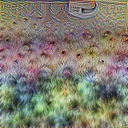

Step 97, Loss 2.812913417816162
2.5958853


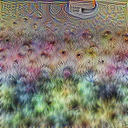

Step 98, Loss 2.3497257232666016
2.8645704


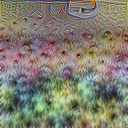

Step 99, Loss 2.417196750640869
2.521321


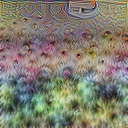

Step 100, Loss 3.1022415161132812
2.753982


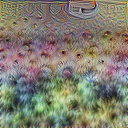

Step 101, Loss 3.106126070022583
2.788463


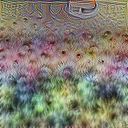

Step 102, Loss 2.737410306930542
2.3789432


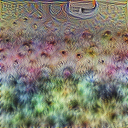

Step 103, Loss 2.594388484954834
2.6810982


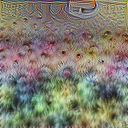

Step 104, Loss 3.1761550903320312
2.550859


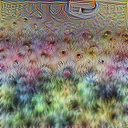

Step 105, Loss 2.9487030506134033
2.836184


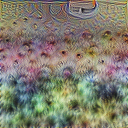

Step 106, Loss 2.512908458709717
2.852367


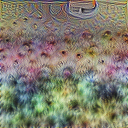

Step 107, Loss 2.608624219894409
2.640378


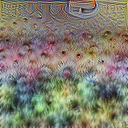

Step 108, Loss 3.0263452529907227
2.7313104


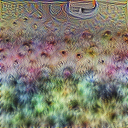

Step 109, Loss 2.251798391342163
2.7132654


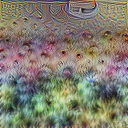

Step 110, Loss 2.2880699634552
2.8659406


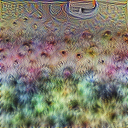

Step 111, Loss 2.9958314895629883
2.8496006


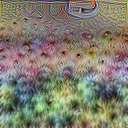

Step 112, Loss 2.564380407333374
2.707942


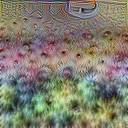

Step 113, Loss 2.727151393890381
2.9170399


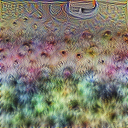

Step 114, Loss 2.6148080825805664
2.8715432


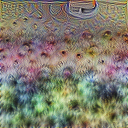

Step 115, Loss 2.6558921337127686
3.1171982


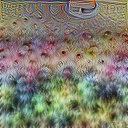

Step 116, Loss 2.544478416442871
2.8683136


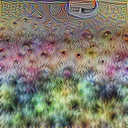

Step 117, Loss 2.980295419692993
2.6599216


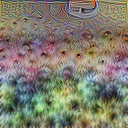

Step 118, Loss 2.6464459896087646
2.613983


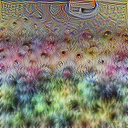

Step 119, Loss 2.4773948192596436
2.4877763


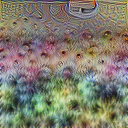

Step 120, Loss 2.403822422027588
2.6236668


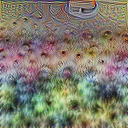

Step 121, Loss 2.521204710006714
2.7557068


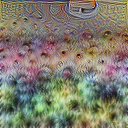

Step 122, Loss 2.993741273880005
2.561971


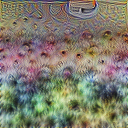

Step 123, Loss 2.418015480041504
2.916271


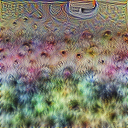

Step 124, Loss 2.4797463417053223
2.9089391


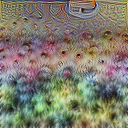

Step 125, Loss 2.5272743701934814
2.8249247


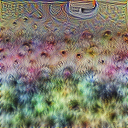

Step 126, Loss 2.898036241531372
2.7341645


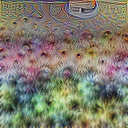

Step 127, Loss 2.935539722442627
2.4995337


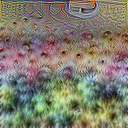

Step 128, Loss 2.954420328140259
2.827385


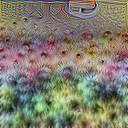

Step 129, Loss 3.0471832752227783
2.812902


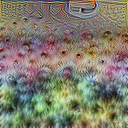

Step 130, Loss 2.474520444869995
2.3285177


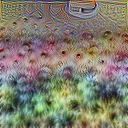

Step 131, Loss 3.0476605892181396
2.826715


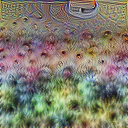

Step 132, Loss 2.6086578369140625
3.0525784


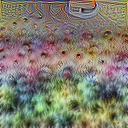

Step 133, Loss 2.6507792472839355
2.8876536


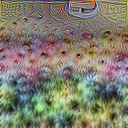

Step 134, Loss 3.033914804458618
2.724679


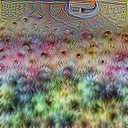

Step 135, Loss 2.5244359970092773
2.8117974


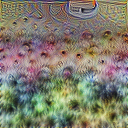

Step 136, Loss 3.151097059249878
2.8961473


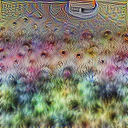

Step 137, Loss 3.041656970977783
3.1348643


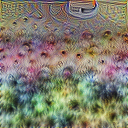

Step 138, Loss 3.3366496562957764
2.891092


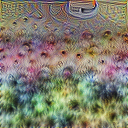

Step 139, Loss 2.7562167644500732
2.631904


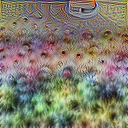

Step 140, Loss 2.67925763130188
2.820465


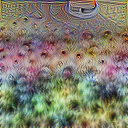

Step 141, Loss 2.8081958293914795
2.5084393


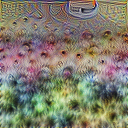

Step 142, Loss 2.6965906620025635
3.2495096


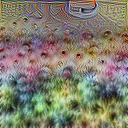

Step 143, Loss 2.895174264907837
3.0012293


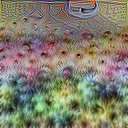

Step 144, Loss 3.0899152755737305
2.9178429


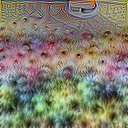

Step 145, Loss 3.435927391052246
2.9531953


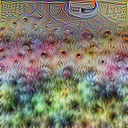

Step 146, Loss 2.4654109477996826
2.8159018


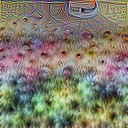

Step 147, Loss 2.8025143146514893
2.8895664


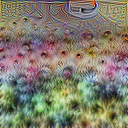

Step 148, Loss 3.1709797382354736
2.908991


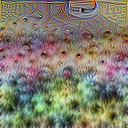

Step 149, Loss 2.795823335647583
2.6970878


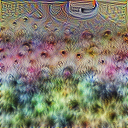

Step 150, Loss 3.414773941040039
2.8961642


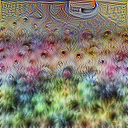

Step 151, Loss 3.1304075717926025
2.9772768


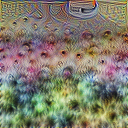

Step 152, Loss 2.546027898788452
2.643012


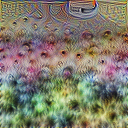

Step 153, Loss 3.1691999435424805
3.4149656


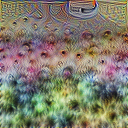

Step 154, Loss 2.5203378200531006
3.138217


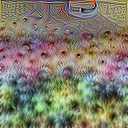

Step 155, Loss 2.967970609664917
2.6818438


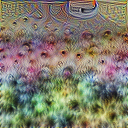

Step 156, Loss 3.2349131107330322
2.5299437


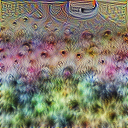

Step 157, Loss 2.4267678260803223
3.1481616


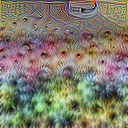

Step 158, Loss 2.738210439682007
3.1189106


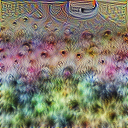

Step 159, Loss 3.267165422439575
3.0757875


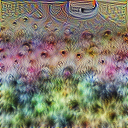

Step 160, Loss 3.202585220336914
3.123361


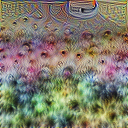

Step 161, Loss 2.7231252193450928
3.1108384


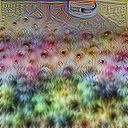

Step 162, Loss 2.89560604095459
2.8257067


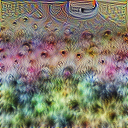

Step 163, Loss 2.812208890914917
3.3744597


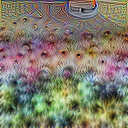

Step 164, Loss 3.123919725418091
2.6707191


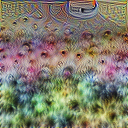

Step 165, Loss 3.5804457664489746
3.5900245


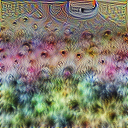

Step 166, Loss 3.054191827774048
2.599893


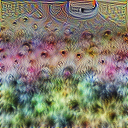

Step 167, Loss 3.2158241271972656
3.4942517


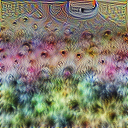

Step 168, Loss 2.6279101371765137
3.166498


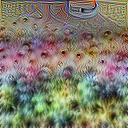

Step 169, Loss 3.327409267425537
3.4709258


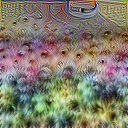

Step 170, Loss 2.929825782775879
2.8631952


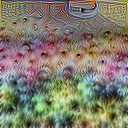

Step 171, Loss 3.114780902862549
2.8925061


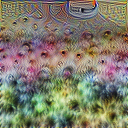

Step 172, Loss 3.0362398624420166
2.9674702


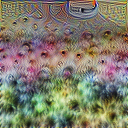

Step 173, Loss 3.1403489112854004
2.7725427


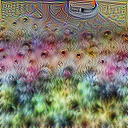

Step 174, Loss 2.592900276184082
2.482785


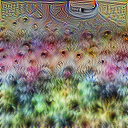

Step 175, Loss 2.7565460205078125
2.672727


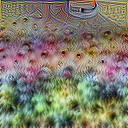

Step 176, Loss 2.5366370677948
2.63802


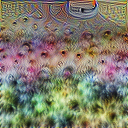

Step 177, Loss 3.4240386486053467
3.392041


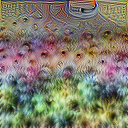

Step 178, Loss 2.708813428878784
2.5728889


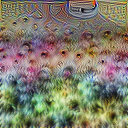

Step 179, Loss 3.294499397277832
2.7926013


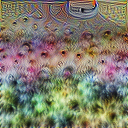

Step 180, Loss 3.5390677452087402
3.2176445


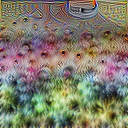

Step 181, Loss 3.280198574066162
3.0405517


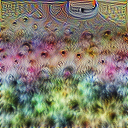

Step 182, Loss 2.8590266704559326
2.635792


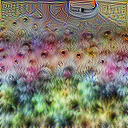

Step 183, Loss 2.860125780105591
2.6928995


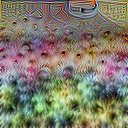

Step 184, Loss 2.531560182571411
3.3069375


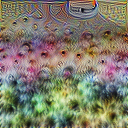

Step 185, Loss 2.867762804031372
2.8305624


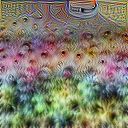

Step 186, Loss 2.593691825866699
2.943888


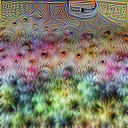

Step 187, Loss 2.9651007652282715
3.2539437


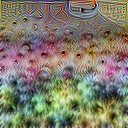

Step 188, Loss 3.406111240386963
3.4729466


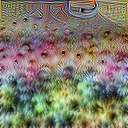

Step 189, Loss 2.753824472427368
2.5846052


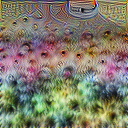

Step 190, Loss 2.7256429195404053
2.6951678


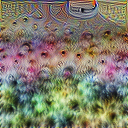

Step 191, Loss 3.428982973098755
2.8065972


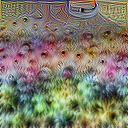

Step 192, Loss 3.0940558910369873
3.3707497


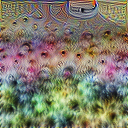

Step 193, Loss 2.7336947917938232
2.6540747


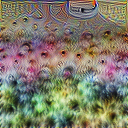

Step 194, Loss 2.815755844116211
2.922216


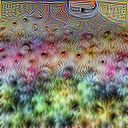

Step 195, Loss 3.1485702991485596
2.659319


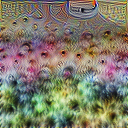

Step 196, Loss 2.79654598236084
3.3883646


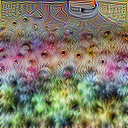

Step 197, Loss 3.151808023452759
2.8974533


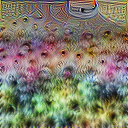

Step 198, Loss 2.8797223567962646
3.1787734


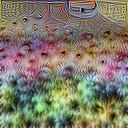

Step 199, Loss 3.190232515335083
3.0373576


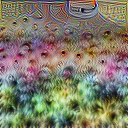

Step 200, Loss 3.5829930305480957
2.6573107


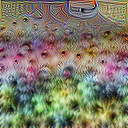

Step 201, Loss 3.274869203567505
2.5971298


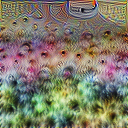

Step 202, Loss 3.1738555431365967
3.3256402


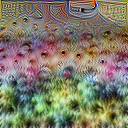

Step 203, Loss 3.002836227416992
2.994041


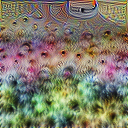

Step 204, Loss 2.6449520587921143
3.0325747


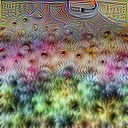

Step 205, Loss 3.021574020385742
2.97653


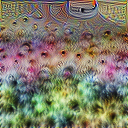

Step 206, Loss 3.114001512527466
3.1177008


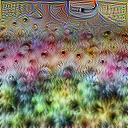

Step 207, Loss 3.123919725418091
3.397222


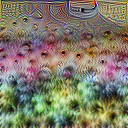

Step 208, Loss 2.6353771686553955
3.226516


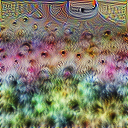

Step 209, Loss 2.7371935844421387
3.1301162


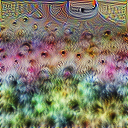

Step 210, Loss 3.427980422973633
2.8640337


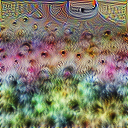

Step 211, Loss 3.4045774936676025
3.0696616


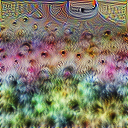

Step 212, Loss 3.1759142875671387
3.098672


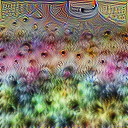

Step 213, Loss 2.866689682006836
2.7855856


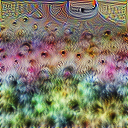

Step 214, Loss 3.3224875926971436
3.1227918


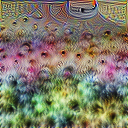

Step 215, Loss 3.544146776199341
3.3120084


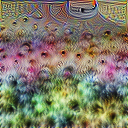

Step 216, Loss 2.7513647079467773
3.3734064


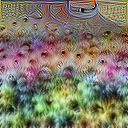

Step 217, Loss 2.699493408203125
2.923392


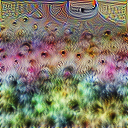

Step 218, Loss 2.8048410415649414
3.0320344


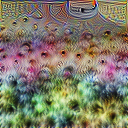

Step 219, Loss 3.159839153289795
2.6760345


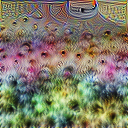

Step 220, Loss 2.8012242317199707
2.8594353


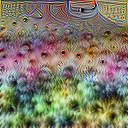

Step 221, Loss 2.4834816455841064
3.0222883


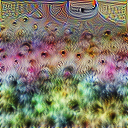

Step 222, Loss 2.9573726654052734
3.0778356


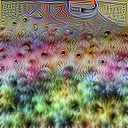

Step 223, Loss 3.2999210357666016
2.7073014


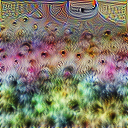

Step 224, Loss 2.8688740730285645
3.200297


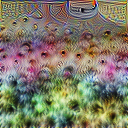

Step 225, Loss 3.5049936771392822
2.955926


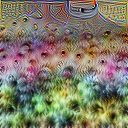

Step 226, Loss 2.8123254776000977
2.7450671


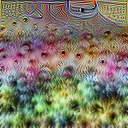

Step 227, Loss 2.8721206188201904
3.04746


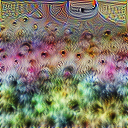

Step 228, Loss 3.2334892749786377
3.7215672


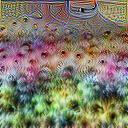

Step 229, Loss 3.101391077041626
2.8855047


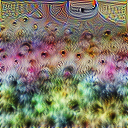

Step 230, Loss 3.1059136390686035
3.1974268


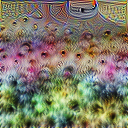

Step 231, Loss 3.0892653465270996
2.9668567


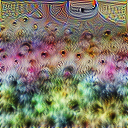

Step 232, Loss 3.083117723464966
2.8662624


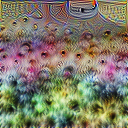

Step 233, Loss 3.0889289379119873
3.3720682


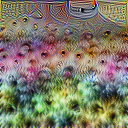

Step 234, Loss 2.868314504623413
3.1988173


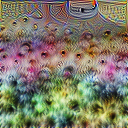

Step 235, Loss 2.9305946826934814
2.7845376


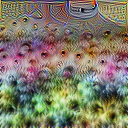

Step 236, Loss 2.7612128257751465
3.466454


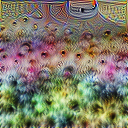

Step 237, Loss 2.703927516937256
3.361882


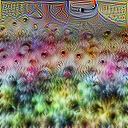

Step 238, Loss 2.5993971824645996
3.0482259


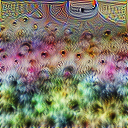

Step 239, Loss 2.7840373516082764
3.239477


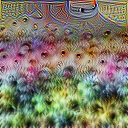

Step 240, Loss 3.780374526977539
3.1387012


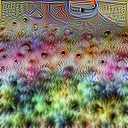

Step 241, Loss 2.838322639465332
2.8309138


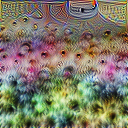

Step 242, Loss 3.3587939739227295
3.048112


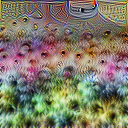

Step 243, Loss 3.140557289123535
2.8135235


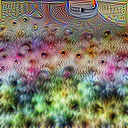

Step 244, Loss 3.0963451862335205
2.7675142


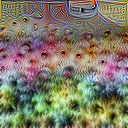

Step 245, Loss 3.2120375633239746
3.1317496


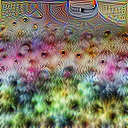

Step 246, Loss 2.999044179916382
3.2062533


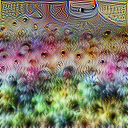

Step 247, Loss 3.1574277877807617
3.2588048


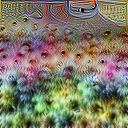

Step 248, Loss 3.0261101722717285
2.9314063


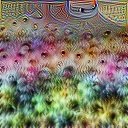

Step 249, Loss 2.744753837585449
2.6321979


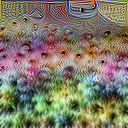

Step 250, Loss 3.2501220703125
3.4962728


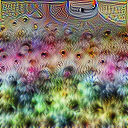

Step 251, Loss 3.32351016998291
3.0906448


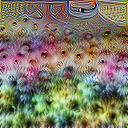

Step 252, Loss 2.668922185897827
3.4103045


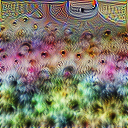

Step 253, Loss 3.3533287048339844
3.2313647


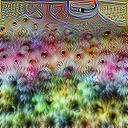

Step 254, Loss 3.257305383682251
3.1635587


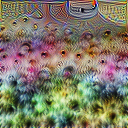

Step 255, Loss 2.4727020263671875
3.1405165


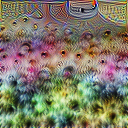

Step 256, Loss 2.7893800735473633
3.476685


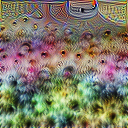

Step 257, Loss 3.0458297729492188
3.5479333


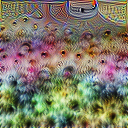

Step 258, Loss 3.2804746627807617
2.6225355


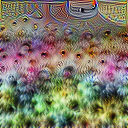

Step 259, Loss 3.2316503524780273
3.0848987


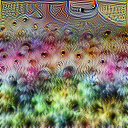

Step 260, Loss 3.1676464080810547
2.835018


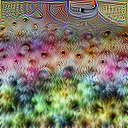

Step 261, Loss 2.865746259689331
2.8968155


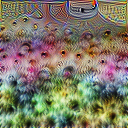

Step 262, Loss 3.424360990524292
3.4890115


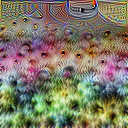

Step 263, Loss 2.9666225910186768
3.4113126


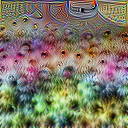

Step 264, Loss 3.770646095275879
3.6020565


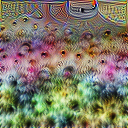

Step 265, Loss 3.6878111362457275
3.1691513


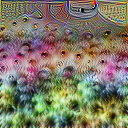

Step 266, Loss 3.3909008502960205
3.3557532


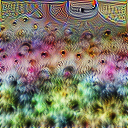

Step 267, Loss 2.9658761024475098
3.6763806


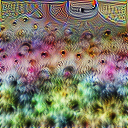

Step 268, Loss 2.9975640773773193
2.978543


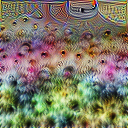

Step 269, Loss 3.4911439418792725
3.1884246


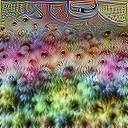

Step 270, Loss 3.3194727897644043
3.407617


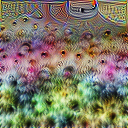

Step 271, Loss 2.9920237064361572
3.5305681


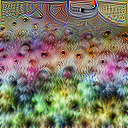

Step 272, Loss 2.6784021854400635
3.0697677


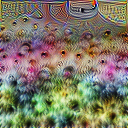

Step 273, Loss 3.24399995803833
3.7239852


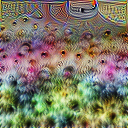

Step 274, Loss 3.1566882133483887
2.8715644


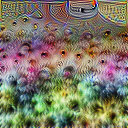

Step 275, Loss 3.2324471473693848
3.0441651


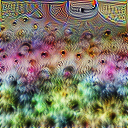

Step 276, Loss 2.9849367141723633
2.9066749


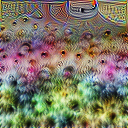

Step 277, Loss 3.774047374725342
2.7354994


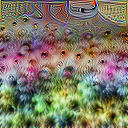

Step 278, Loss 3.047666072845459
3.2386441


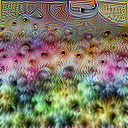

Step 279, Loss 3.198897361755371
3.5146236


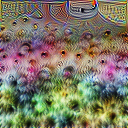

Step 280, Loss 2.7096197605133057
3.7616901


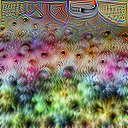

Step 281, Loss 3.216024160385132
3.389719


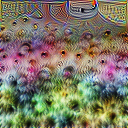

Step 282, Loss 3.3905467987060547
3.6561875


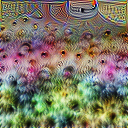

Step 283, Loss 3.3140907287597656
2.7865086


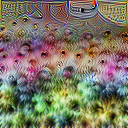

Step 284, Loss 2.937304735183716
3.1728535


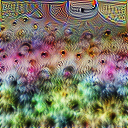

Step 285, Loss 3.3855888843536377
3.278992


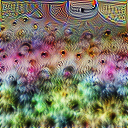

Step 286, Loss 3.2756707668304443
3.216985


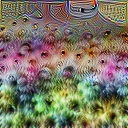

Step 287, Loss 3.4982709884643555
3.0335624


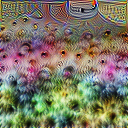

Step 288, Loss 2.5467634201049805
3.2168643


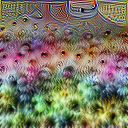

Step 289, Loss 3.2046375274658203
3.066705


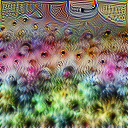

Step 290, Loss 3.3085081577301025
3.9455185


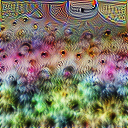

Step 291, Loss 3.0176196098327637
2.750676


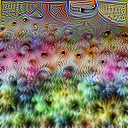

Step 292, Loss 3.3339147567749023
3.3633716


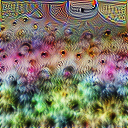

Step 293, Loss 3.4543333053588867
2.526397


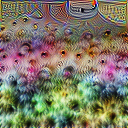

Step 294, Loss 3.0807957649230957
3.6552312


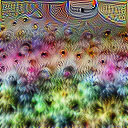

Step 295, Loss 2.9991700649261475
3.7773478


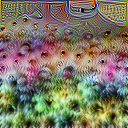

Step 296, Loss 3.184779405593872
3.5030887


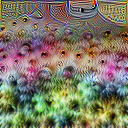

Step 297, Loss 3.0862607955932617
3.3622196


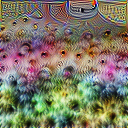

Step 298, Loss 3.7626914978027344
3.6313634


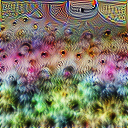

Step 299, Loss 3.174329996109009
3.0693922


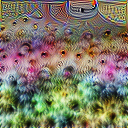

Step 300, Loss 3.2683331966400146
2.9041271


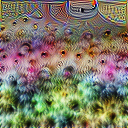

Step 301, Loss 2.9382333755493164
3.2407804


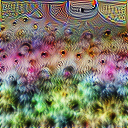

Step 302, Loss 2.9977025985717773
3.8850222


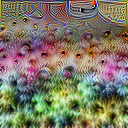

Step 303, Loss 3.174394369125366
2.8580732


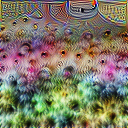

Step 304, Loss 2.778287887573242
3.6452727


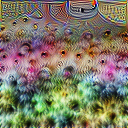

Step 305, Loss 3.2406628131866455
2.90797


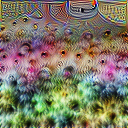

Step 306, Loss 3.3106307983398438
2.7827106


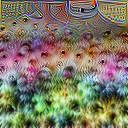

Step 307, Loss 3.2226362228393555
3.0968018


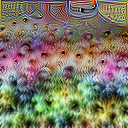

Step 308, Loss 3.191854238510132
3.128735


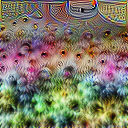

Step 309, Loss 3.166884422302246
3.1493058


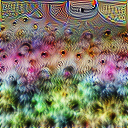

Step 310, Loss 2.961207866668701
3.4239419


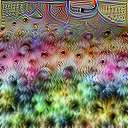

Step 311, Loss 3.117166519165039
3.8050838


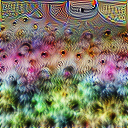

Step 312, Loss 3.570882797241211
2.9239578


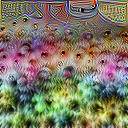

Step 313, Loss 2.986541748046875
2.8585453


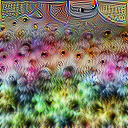

Step 314, Loss 3.3407630920410156
3.998441


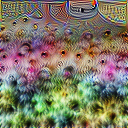

Step 315, Loss 3.127023220062256
3.0762453


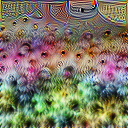

Step 316, Loss 3.515183687210083
2.9060242


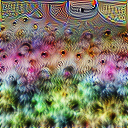

Step 317, Loss 3.0836026668548584
3.4789042


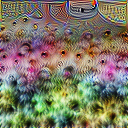

Step 318, Loss 3.5818331241607666
3.422278


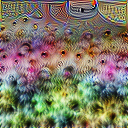

Step 319, Loss 3.8391215801239014
3.240434


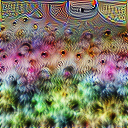

Step 320, Loss 3.9045960903167725
3.2283456


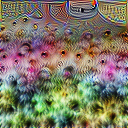

Step 321, Loss 2.6269543170928955
2.699086


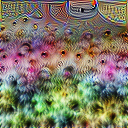

Step 322, Loss 3.5289177894592285
2.8068805


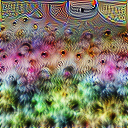

Step 323, Loss 3.7185475826263428
3.6053414


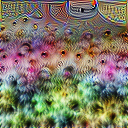

Step 324, Loss 3.0311553478240967
3.2616618


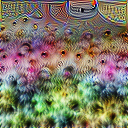

Step 325, Loss 2.961024284362793
3.604611


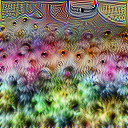

Step 326, Loss 3.078000545501709
3.3569014


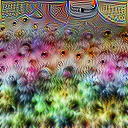

Step 327, Loss 3.076629877090454
3.4210217


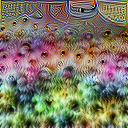

Step 328, Loss 3.817814350128174
3.4255114


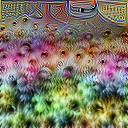

Step 329, Loss 3.2166786193847656
3.339595


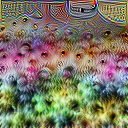

Step 330, Loss 3.0161194801330566
3.9279234


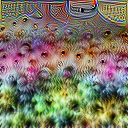

Step 331, Loss 3.7713189125061035
3.4330738


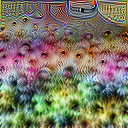

Step 332, Loss 3.2642245292663574
3.3953335


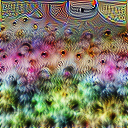

Step 333, Loss 3.6991841793060303
3.3573687


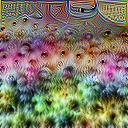

Step 334, Loss 2.8443002700805664
3.11659


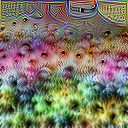

Step 335, Loss 3.684809923171997
3.3024786


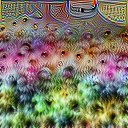

Step 336, Loss 2.9161148071289062
2.695014


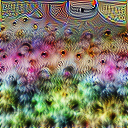

Step 337, Loss 3.031432628631592
2.9476643


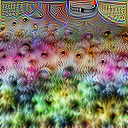

Step 338, Loss 2.7889535427093506
3.4722042


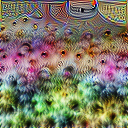

Step 339, Loss 3.073392868041992
3.269884


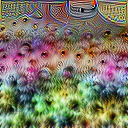

Step 340, Loss 2.9127578735351562
3.1999004


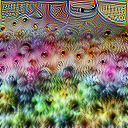

Step 341, Loss 3.534212112426758
3.5536714


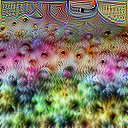

Step 342, Loss 3.6840779781341553
2.8338752


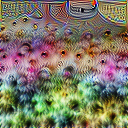

Step 343, Loss 3.802907705307007
2.801952


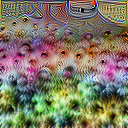

Step 344, Loss 3.353975534439087
3.8884764


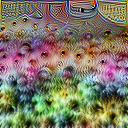

Step 345, Loss 3.417362928390503
3.283609


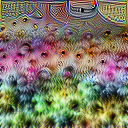

Step 346, Loss 3.8641629219055176
3.0773435


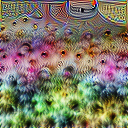

Step 347, Loss 4.023871898651123
3.4260113


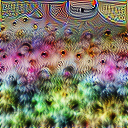

Step 348, Loss 3.298562526702881
3.1662745


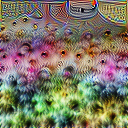

Step 349, Loss 3.6519150733947754
3.3696373


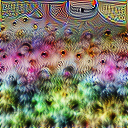

Step 350, Loss 2.9319839477539062
3.3295443


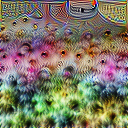

Step 351, Loss 2.75052547454834
2.993448


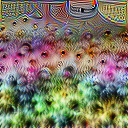

Step 352, Loss 3.2472381591796875
3.97583


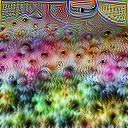

Step 353, Loss 2.9826340675354004
3.1944444


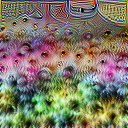

Step 354, Loss 3.993227005004883
4.041663


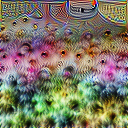

Step 355, Loss 3.161936044692993
3.331535


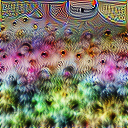

Step 356, Loss 3.669419288635254
3.620347


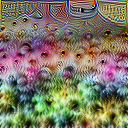

Step 357, Loss 2.9891247749328613
2.8785737


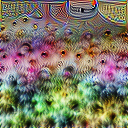

Step 358, Loss 3.3911004066467285
3.3472931


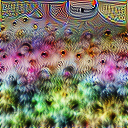

Step 359, Loss 3.1550772190093994
3.460402


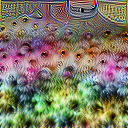

Step 360, Loss 3.381467580795288
3.1143944


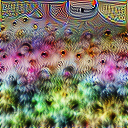

Step 361, Loss 3.671189785003662
2.8068693


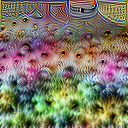

Step 362, Loss 3.0298712253570557
3.009948


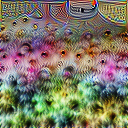

Step 363, Loss 3.3466849327087402
3.0842001


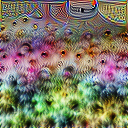

Step 364, Loss 3.716449499130249
3.8427486


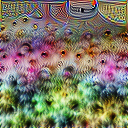

Step 365, Loss 3.5620248317718506
3.5299983


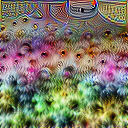

Step 366, Loss 3.679655075073242
3.0011368


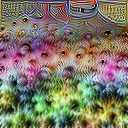

Step 367, Loss 3.009791374206543
3.9197485


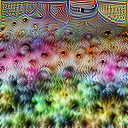

Step 368, Loss 3.3189661502838135
3.1820054


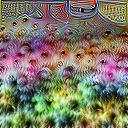

Step 369, Loss 3.4865410327911377
3.0275822


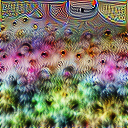

Step 370, Loss 3.5030670166015625
2.8114274


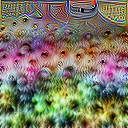

Step 371, Loss 3.2680468559265137
3.2477362


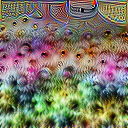

Step 372, Loss 3.049593687057495
3.378188


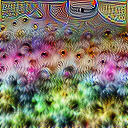

Step 373, Loss 3.6204051971435547
3.9069414


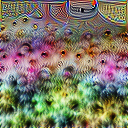

Step 374, Loss 3.928159713745117
3.5158236


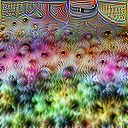

Step 375, Loss 2.9039666652679443
3.140144


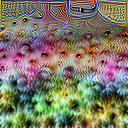

Step 376, Loss 3.4460794925689697
3.7043858


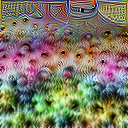

Step 377, Loss 3.2565512657165527
3.0657666


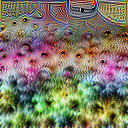

Step 378, Loss 3.479144811630249
3.3933377


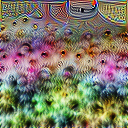

Step 379, Loss 3.3625755310058594
3.5539303


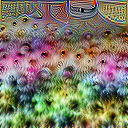

Step 380, Loss 3.3785507678985596
3.1910617


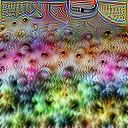

Step 381, Loss 3.4990525245666504
3.4378128


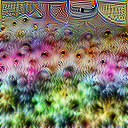

Step 382, Loss 3.9288675785064697
3.4000788


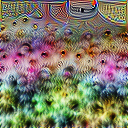

Step 383, Loss 2.936601161956787
2.8865771


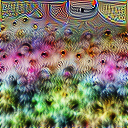

Step 384, Loss 3.108292579650879
3.145639


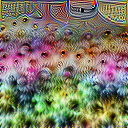

Step 385, Loss 3.212301015853882
3.5969334


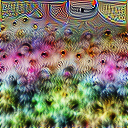

Step 386, Loss 3.638643264770508
3.6272016


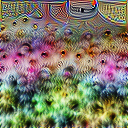

Step 387, Loss 3.6432862281799316
4.0515823


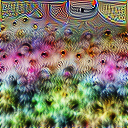

Step 388, Loss 4.165872573852539
3.141732


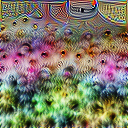

Step 389, Loss 3.1038999557495117
3.6590805


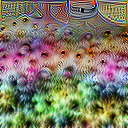

Step 390, Loss 3.7263996601104736
2.8356938


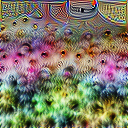

Step 391, Loss 3.570054531097412
3.318757


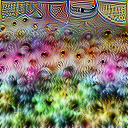

Step 392, Loss 3.622476577758789
3.8294835


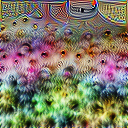

Step 393, Loss 3.645343542098999
2.8000824


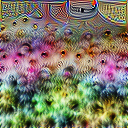

Step 394, Loss 2.9675862789154053
3.1684766


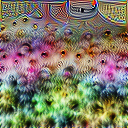

Step 395, Loss 3.418778896331787
3.025469


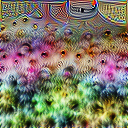

Step 396, Loss 3.160447597503662
3.6609783


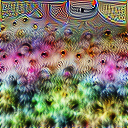

Step 397, Loss 3.3627426624298096
3.4464679


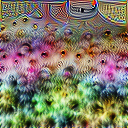

Step 398, Loss 3.602205514907837
3.7206602


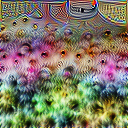

Step 399, Loss 3.560293197631836
3.2219665


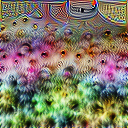

Step 400, Loss 3.5800399780273438
3.233649


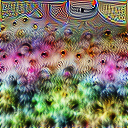

Step 401, Loss 3.1290390491485596
3.0834517


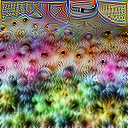

Step 402, Loss 3.7119314670562744
3.9458115


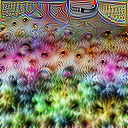

Step 403, Loss 3.026733875274658
3.1264727


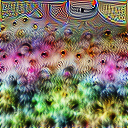

Step 404, Loss 3.9280240535736084
3.739174


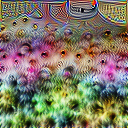

Step 405, Loss 3.5395402908325195
3.9261284


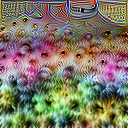

Step 406, Loss 3.2726705074310303
3.7028184


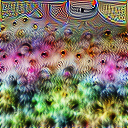

Step 407, Loss 3.252875804901123
3.7652996


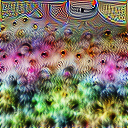

Step 408, Loss 3.205803155899048
3.6248538


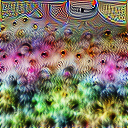

Step 409, Loss 3.4864630699157715
3.3386369


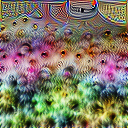

Step 410, Loss 3.74649715423584
3.1705985


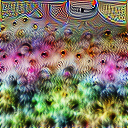

Step 411, Loss 3.4240846633911133
3.7533305


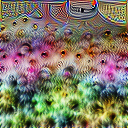

Step 412, Loss 3.1208245754241943
3.0731323


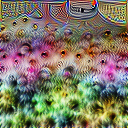

Step 413, Loss 3.6899561882019043
3.3876462


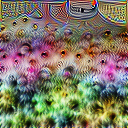

Step 414, Loss 3.4319326877593994
4.130993


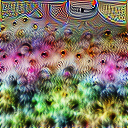

Step 415, Loss 3.2184648513793945
3.5349667


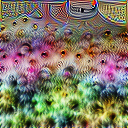

Step 416, Loss 3.938990831375122
2.810444


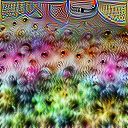

Step 417, Loss 3.447044849395752
3.0879765


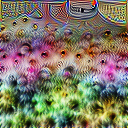

Step 418, Loss 3.095198392868042
3.5498407


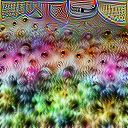

Step 419, Loss 3.5631110668182373
3.1972892


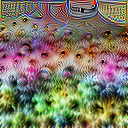

Step 420, Loss 3.6451783180236816
3.552205


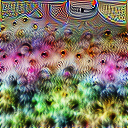

Step 421, Loss 3.381484031677246
3.4649467


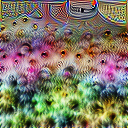

Step 422, Loss 4.107295513153076
3.1404545


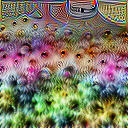

Step 423, Loss 3.013241767883301
3.7275703


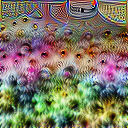

Step 424, Loss 3.276507616043091
3.2011957


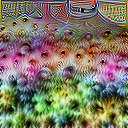

Step 425, Loss 3.1204137802124023
3.9611897


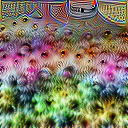

Step 426, Loss 3.056623935699463
3.1332834


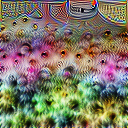

Step 427, Loss 2.879159450531006
2.7567935


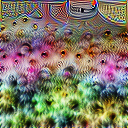

Step 428, Loss 3.416987657546997
2.9854758


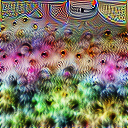

Step 429, Loss 3.471165657043457
3.6345446


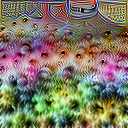

Step 430, Loss 3.0818874835968018
3.7061448


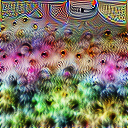

Step 431, Loss 3.2872555255889893
3.4126682


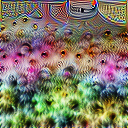

Step 432, Loss 3.479997396469116
3.2364142


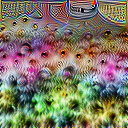

Step 433, Loss 3.041719436645508
3.456477


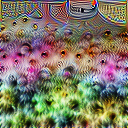

Step 434, Loss 3.1922338008880615
3.2083242


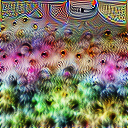

Step 435, Loss 3.994722604751587
3.1271887


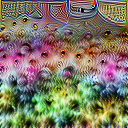

Step 436, Loss 3.7684409618377686
3.799778


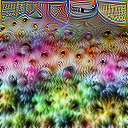

Step 437, Loss 3.821500778198242
3.1585248


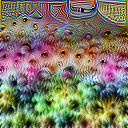

Step 438, Loss 3.4906744956970215
3.5436268


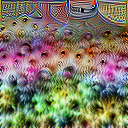

Step 439, Loss 3.407970666885376
2.8610353


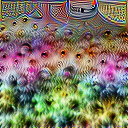

Step 440, Loss 2.967607021331787
3.2865095


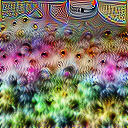

Step 441, Loss 3.900843858718872
2.971181


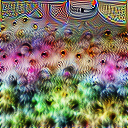

Step 442, Loss 3.044857978820801
3.1307826


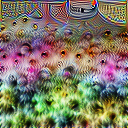

Step 443, Loss 3.294743299484253
3.9116354


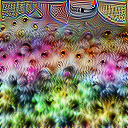

Step 444, Loss 3.1247096061706543
3.4398065


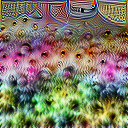

Step 445, Loss 3.3989410400390625
3.488774


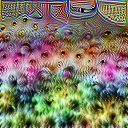

Step 446, Loss 3.8443570137023926
4.1768255


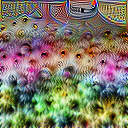

Step 447, Loss 3.6564557552337646
3.1907065


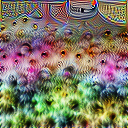

Step 448, Loss 2.9883198738098145
3.3980367


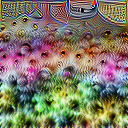

Step 449, Loss 3.2931721210479736
3.576476


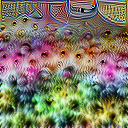

Step 450, Loss 3.052053213119507
3.4790583


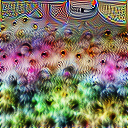

Step 451, Loss 3.745436191558838
3.408022


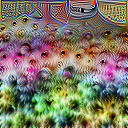

Step 452, Loss 3.451148271560669
3.858556


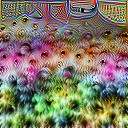

Step 453, Loss 3.4837112426757812
3.6210265


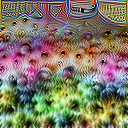

Step 454, Loss 3.263484239578247
3.850555


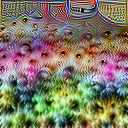

Step 455, Loss 3.6495730876922607
4.023733


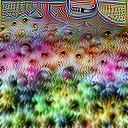

Step 456, Loss 3.2773396968841553
3.6281435


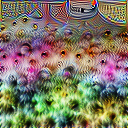

Step 457, Loss 3.7734382152557373
3.22057


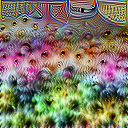

Step 458, Loss 3.3163490295410156
3.554487


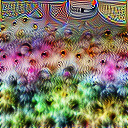

Step 459, Loss 2.913480520248413
3.1655161


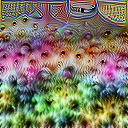

Step 460, Loss 3.9071543216705322
3.365539


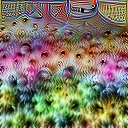

Step 461, Loss 3.386716604232788
3.8100123


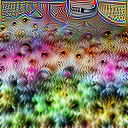

Step 462, Loss 3.2272255420684814
3.2460191


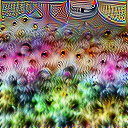

Step 463, Loss 3.914175510406494
3.338416


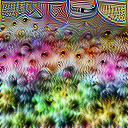

Step 464, Loss 3.5483696460723877
3.8050265


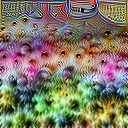

Step 465, Loss 3.5608417987823486
3.3482435


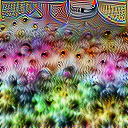

Step 466, Loss 3.381964683532715
3.0854497


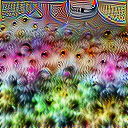

Step 467, Loss 3.5455896854400635
3.7123106


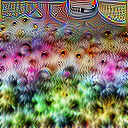

Step 468, Loss 3.9345016479492188
3.5732784


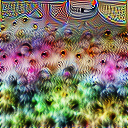

Step 469, Loss 3.747478485107422
3.124441


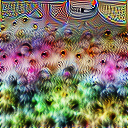

Step 470, Loss 3.2114672660827637
3.15598


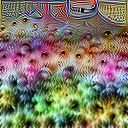

Step 471, Loss 3.6573803424835205
3.6366303


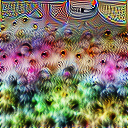

Step 472, Loss 3.8571784496307373
3.6281128


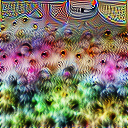

Step 473, Loss 3.9578375816345215
3.0043087


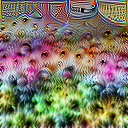

Step 474, Loss 3.246284008026123
3.8826468


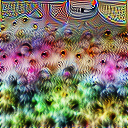

Step 475, Loss 3.7375476360321045
3.4440584


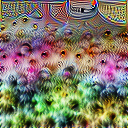

Step 476, Loss 3.214120388031006
3.2450495


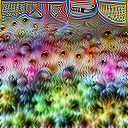

Step 477, Loss 3.226710557937622
2.9708414


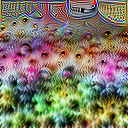

Step 478, Loss 3.146902322769165
2.975853


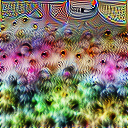

Step 479, Loss 3.568770408630371
3.4432905


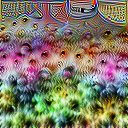

Step 480, Loss 3.390237808227539
4.019445


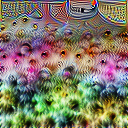

Step 481, Loss 3.3538620471954346
3.6775603


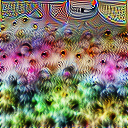

Step 482, Loss 3.037386178970337
3.0957916


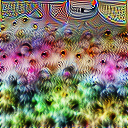

Step 483, Loss 3.040599822998047
3.5400782


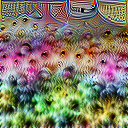

Step 484, Loss 3.4552807807922363
3.736453


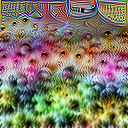

Step 485, Loss 3.1191654205322266
3.7908342


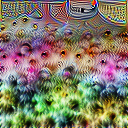

Step 486, Loss 3.9190025329589844
3.590837


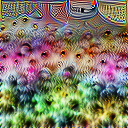

Step 487, Loss 3.7340872287750244
3.85109


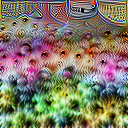

Step 488, Loss 3.652926206588745
3.5387735


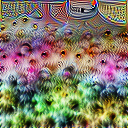

Step 489, Loss 2.848818063735962
3.5189576


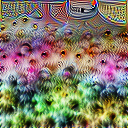

Step 490, Loss 3.5499229431152344
3.0558476


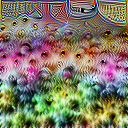

Step 491, Loss 2.8544089794158936
3.1699243


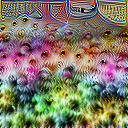

Step 492, Loss 3.5219368934631348
3.723908


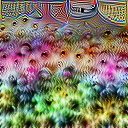

Step 493, Loss 3.342052698135376
3.2356482


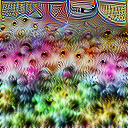

Step 494, Loss 3.748441457748413
3.4375052


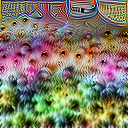

Step 495, Loss 3.142629384994507
3.1218934


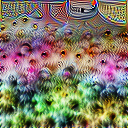

Step 496, Loss 3.6064043045043945
3.3097324


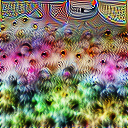

Step 497, Loss 3.7259299755096436
3.0245104


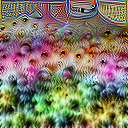

Step 498, Loss 4.4392242431640625
3.6302352


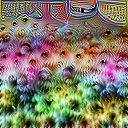

Step 499, Loss 3.057079792022705
3.3151124


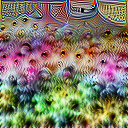

Step 500, Loss 3.1141371726989746
3.9005759


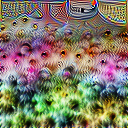

Step 501, Loss 3.5926949977874756
3.2208107


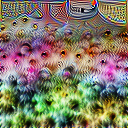

Step 502, Loss 2.961571216583252
3.7499905


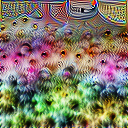

Step 503, Loss 2.860536575317383
3.6889184


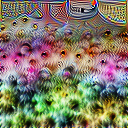

Step 504, Loss 3.3297998905181885
3.6150804


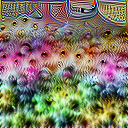

Step 505, Loss 3.9115867614746094
3.5259154


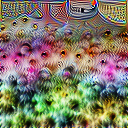

Step 506, Loss 3.1404738426208496
3.2255268


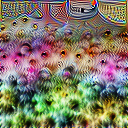

Step 507, Loss 2.9952352046966553
3.2045736


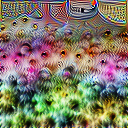

Step 508, Loss 3.1463534832000732
3.2364812


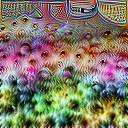

Step 509, Loss 3.1885414123535156
3.9901054


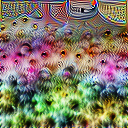

Step 510, Loss 3.2863192558288574
3.0265887


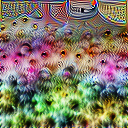

Step 511, Loss 3.9431285858154297
2.9648025


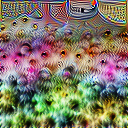

In [31]:
with tf.Graph().as_default() as graph, tf.Session() as sess:
    
    ## create the objective function through lucid by specifyingt he channel we are about to optimise
    T = render.make_vis_T(model, layer_channel) 
    
    tf.initialize_all_variables().run() ## Initialises all variables in the graph, the input is now a random image
    
    show(T("input").eval()[0])
    for i in range(512):
        T("vis_op").run()
        print("Step {}, Loss {}".format(i,T("loss").eval()))
        print(T("loss").eval())
        show(T("input").eval()[0])

Starting from a random image , we could see the network produces images that reflect some artefacts of the training dataset as the optimisation evolves. Since imagenet is mostly comprised of dog classes,the visualisation reflects dog heads.

A network is composed of many hidden layers and you could pick either a neuron/channel/layer as your objective. Below we list out the different operations and you can pick your target.

In [32]:
# looking at various operations in the graph
tf.import_graph_def(model.graph_def)
with tf.get_default_graph().as_default() as g:
    ops=g.get_operations()
for i in range(len(ops)):
    print(ops[i].outputs)

[<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>]
[<tf.Tensor 'block1_conv1/kernel/Initializer/random_uniform/shape:0' shape=(4,) dtype=int32>]
[<tf.Tensor 'block1_conv1/kernel/Initializer/random_uniform/min:0' shape=() dtype=float32>]
[<tf.Tensor 'block1_conv1/kernel/Initializer/random_uniform/max:0' shape=() dtype=float32>]
[<tf.Tensor 'block1_conv1/kernel/Initializer/random_uniform/RandomUniform:0' shape=(3, 3, 3, 64) dtype=float32>]
[<tf.Tensor 'block1_conv1/kernel/Initializer/random_uniform/sub:0' shape=() dtype=float32>]
[<tf.Tensor 'block1_conv1/kernel/Initializer/random_uniform/mul:0' shape=(3, 3, 3, 64) dtype=float32>]
[<tf.Tensor 'block1_conv1/kernel/Initializer/random_uniform:0' shape=(3, 3, 3, 64) dtype=float32>]
[<tf.Tensor 'block1_conv1/kernel:0' shape=() dtype=resource>]
[<tf.Tensor 'block1_conv1/kernel/IsInitialized/VarIsInitializedOp:0' shape=() dtype=bool>]
[]
[<tf.Tensor 'block1_conv1/kernel/Read/ReadVariableOp:0' shape=(3, 3, 3, 64) dtype=float32>]
[<tf

[<tf.Tensor 'ReadVariableOp:0' shape=(3, 3, 3, 64) dtype=float32>]
[<tf.Tensor 'Placeholder_1:0' shape=(64,) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_1:0' shape=(64,) dtype=float32>]
[<tf.Tensor 'Placeholder_2:0' shape=(3, 3, 64, 64) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_2:0' shape=(3, 3, 64, 64) dtype=float32>]
[<tf.Tensor 'Placeholder_3:0' shape=(64,) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_3:0' shape=(64,) dtype=float32>]
[<tf.Tensor 'Placeholder_4:0' shape=(3, 3, 64, 128) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_4:0' shape=(3, 3, 64, 128) dtype=float32>]
[<tf.Tensor 'Placeholder_5:0' shape=(128,) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_5:0' shape=(128,) dtype=float32>]
[<tf.Tensor 'Placeholder_6:0' shape=(3, 3, 128, 128) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_6:0' shape=(3, 3, 128, 128) dtype=float32>]
[<tf.Tensor 'Placeholder_7:0' shape=(128,) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_7:0' shape=(128,) dtype=float32>]
[<tf.Tensor 'Pl

[<tf.Tensor 'block3_conv1_1/Conv2D/ReadVariableOp:0' shape=(3, 3, 128, 256) dtype=float32>]
[<tf.Tensor 'block3_conv1_1/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>]
[<tf.Tensor 'block3_conv1_1/BiasAdd/ReadVariableOp:0' shape=(256,) dtype=float32>]
[<tf.Tensor 'block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]
[<tf.Tensor 'block3_conv1_1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>]
[<tf.Tensor 'block3_conv2_1/kernel/Initializer/random_uniform/shape:0' shape=(4,) dtype=int32>]
[<tf.Tensor 'block3_conv2_1/kernel/Initializer/random_uniform/min:0' shape=() dtype=float32>]
[<tf.Tensor 'block3_conv2_1/kernel/Initializer/random_uniform/max:0' shape=() dtype=float32>]
[<tf.Tensor 'block3_conv2_1/kernel/Initializer/random_uniform/RandomUniform:0' shape=(3, 3, 256, 256) dtype=float32>]
[<tf.Tensor 'block3_conv2_1/kernel/Initializer/random_uniform/sub:0' shape=() dtype=float32>]
[<tf.Tensor 'block3_conv2_1/kernel/Initializer/random_uniform/mul:0' shape=(3, 3, 256, 256) dtype=f

[<tf.Tensor 'ReadVariableOp_32:0' shape=(3, 3, 3, 64) dtype=float32>]
[<tf.Tensor 'Placeholder_33:0' shape=(64,) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_33:0' shape=(64,) dtype=float32>]
[<tf.Tensor 'Placeholder_34:0' shape=(3, 3, 64, 64) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_34:0' shape=(3, 3, 64, 64) dtype=float32>]
[<tf.Tensor 'Placeholder_35:0' shape=(64,) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_35:0' shape=(64,) dtype=float32>]
[<tf.Tensor 'Placeholder_36:0' shape=(3, 3, 64, 128) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_36:0' shape=(3, 3, 64, 128) dtype=float32>]
[<tf.Tensor 'Placeholder_37:0' shape=(128,) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_37:0' shape=(128,) dtype=float32>]
[<tf.Tensor 'Placeholder_38:0' shape=(3, 3, 128, 128) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_38:0' shape=(3, 3, 128, 128) dtype=float32>]
[<tf.Tensor 'Placeholder_39:0' shape=(128,) dtype=float32>]
[]
[<tf.Tensor 'ReadVariableOp_39:0' shape=(128,) dtype=float32>

Above, we have listed all the operations,the same could also be explored visually using tensorboard. We can use the operation names along with the dimension to pick our target. For example the final operation is the predictions, which is of shape (batch_size,1001). In case if we are looking for pre-softmax output , then we need to trace above from prediction and look for the tensor before softmax operation. If we are looking for a specific layer say Mixed_5c then we need to look up for its name and pick the earliest tensor from the bottom.

## 3.2.4 Visualising Neurons,Layers and channels:

We did the above exercise to get an insight on how the input image evolves in the course of optimisation process. Lucid also provides us a way to specify the objective and get back the visualisation which is illustrated below.

W1107 20:22:28.943521 139678969603904 deprecation.py:323] From /home/peerless/anaconda3/lib/python3.7/site-packages/lucid-0.3.9-py3.7.egg/lucid/misc/redirected_relu_grad.py:95: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


512 [11.136897]


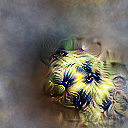

In [33]:
#let's visualize the information encoded in a particular neuron for the following layer and channel
layer = "InceptionV1/InceptionV1/Mixed_4b/concat" # layer
channel = 50 # channel

# the feature map size of the above layer is (14,14,512) i.e. it has 512 channels
# it has 14x14 neurons to choose for each channel
# neuron position in the channel
x_pos = 5 
y_pos = 5


# we now define the objective of a neuron by passing the required arguments
obj = objectives.neuron(layer, channel, x_pos, y_pos)
# we now render the output by optimizing the objective
_ = render.render_vis(model, obj,  use_fixed_seed=True)

512 9.643604


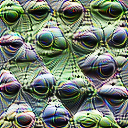

In [34]:
# Lets visualize the channel (we have done this to begin with)
channel = 100
obj = objectives.channel(layer, channel)
_ = render.render_vis(model, obj)

512 9.937276


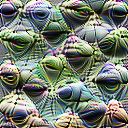

In [35]:
# visualizing another channel
obj = objectives.channel(layer, 100)
_ = render.render_vis(model, obj)

512 9.252118


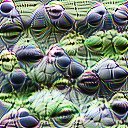

In [36]:
# visualizing the combination of channels
channel = lambda n: objectives.channel(layer, n)
obj = channel(100) + channel(250)
_ = render.render_vis(model, obj)

Objectives expects a scalar, by setting it up as a sum of two channels,we are trying to visualise what both the channels together are looking for in the image.

512 4.689054


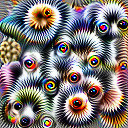

In [37]:
# visualizing a layer
obj = objectives.deepdream(layer)
_ = render.render_vis(model, obj)

We could also visualise specify the entire channel as an objective and we get an illustration of what the specific layer is looking for.The above visualisation indicates that the channel is looking for dog faces.

## 3.2.5 Visualisation of Pre-Softmax Layer

So far we have focussed on intermediate layers, which might learn some features that aid in final classsification. If we want to create images that resemble a specific class of examples, then we can either visualise the final layer or the pre-softmax layer. The pre-softmax layer results in crispy images, so lets track that operation and set up lucid objectives.

In [38]:
# List down the final operations in the network.
ops[-10:-1]


[<tf.Operation 'import/InceptionV1/Logits/Conv2d_0c_1x1/biases' type=Const>,
 <tf.Operation 'import/InceptionV1/Logits/Conv2d_0c_1x1/biases/read' type=Identity>,
 <tf.Operation 'import/InceptionV1/Logits/Conv2d_0c_1x1/Conv2D' type=Conv2D>,
 <tf.Operation 'import/InceptionV1/Logits/Conv2d_0c_1x1/BiasAdd' type=BiasAdd>,
 <tf.Operation 'import/InceptionV1/Logits/SpatialSqueeze' type=Squeeze>,
 <tf.Operation 'import/InceptionV1/Logits/Predictions/Reshape/shape' type=Const>,
 <tf.Operation 'import/InceptionV1/Logits/Predictions/Reshape' type=Reshape>,
 <tf.Operation 'import/InceptionV1/Logits/Predictions/Softmax' type=Softmax>,
 <tf.Operation 'import/InceptionV1/Logits/Predictions/Shape' type=Shape>]

In [39]:
# we could spot softmax and we would want the tensor before its reshaped

print(ops[-7])
print(ops[-7].outputs)

name: "import/InceptionV1/Logits/Conv2d_0c_1x1/BiasAdd"
op: "BiasAdd"
input: "import/InceptionV1/Logits/Conv2d_0c_1x1/Conv2D"
input: "import/InceptionV1/Logits/Conv2d_0c_1x1/biases/read"
attr {
  key: "T"
  value {
    type: DT_FLOAT
  }
}
attr {
  key: "data_format"
  value {
    s: "NHWC"
  }
}

[<tf.Tensor 'import/InceptionV1/Logits/Conv2d_0c_1x1/BiasAdd:0' shape=(?, 1, 1, 1001) dtype=float32>]


In [40]:
# lets visualize the information stored in encoding 9 of 1001 which corresponds to  class hen
model.labels[9]

'hen'

64 38.339066


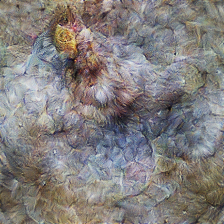

128 38.872555


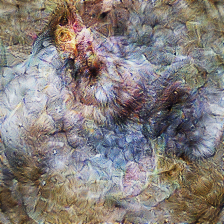

256 49.973843


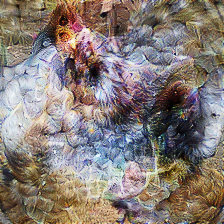

512 67.630325


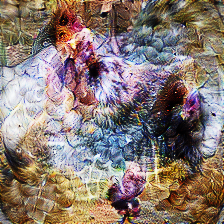

In [41]:
pre_sm_la = 'InceptionV1/Logits/Conv2d_0c_1x1/BiasAdd' # pre softmax layer
label_index = 9

param_f=lambda : param.image(w=224,h=224,batch=1)
obj=objectives.channel(pre_sm_la,label_index)
_=render.render_vis(model,objective_f=obj,param_f=param_f,thresholds=(64,128,256,512))

We can see from the above outputs that the encodings does capture significant information of the object.<br>
In this case we can see the feather patterns, the yellow color at the head region of hens have been captured nicely.

In [42]:
# EXERCISE

#Set up the objective function to  visualise umberlla class from imagenet whose id is 880

label_id =880
model.labels[880]

'umbrella'

64 49.3478


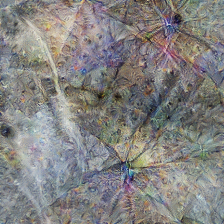

128 53.964146


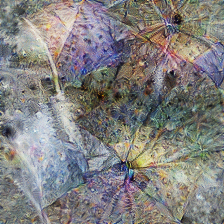

256 62.740517


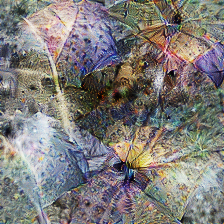

512 80.9862


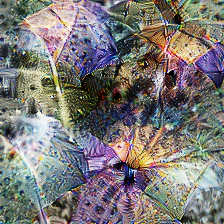

In [43]:
pre_sm_la = 'InceptionV1/Logits/Conv2d_0c_1x1/BiasAdd' # pre softmax layer
label_index = 880

param_f=lambda : param.image(w=224,h=224,batch=1)
obj=objectives.channel(pre_sm_la,label_index)
_=render.render_vis(model,objective_f=obj,param_f=param_f,thresholds=(64,128,256,512))

You must be able to spot structures similar to umberlla class in your visualisations.

## 3.3 Inverting Representations:

We are aware that neural networks are function approximators and specifically, CNN's take in image as input and give us an alternate representation of the image that is quite useful for the specific task in hand such as classification/segmentation etc. In the previous sections, we looked at how to visualise the hidden layers and also what does a neural network look for in internal layers.  In this section we are looking at techniques that help us understand information contained within these representations obtained from a neural network.<br>


We pass an image as input to the network, obtain a features at multiple levels and try to reconstruct the input from just these features.




## Inversion as optimisation:

Formally we can describe the function a neural network learns as,<br><br>  $\Phi(x)$ which takes in an input image $x   \in  {R}^{W*H*C}$ and produces an representaion $y= \Phi(x) \in {R}^{d}$.<br>


<img src = "../images/transformation_1.jpeg">

In the process of transformation the network stripes off unnecessary information and retains those that are required for the classification. We can intepret this function as a process of encoding where the image  is converted in to a code, to be analysed by the classifier present in the final layer. 

There is a common criticism on neural networks that such internal codes aren't intepretable , since they are at an abstract space. What if we can start from one such internal code and produce a visualisation ,will it reveal the properties a neural network is looking for? This was the motivating question behind feature inversion. Here we start from an encoding and try to identify an image that could have resulted in this code. Rather than going from an image to a code,we start with the code and try to retrieve the image that has resulted in this code.

In [44]:
## Reference


# Import libraries
import numpy as np
import tensorflow as tf
import scipy.ndimage as nd

#from google.colab import files

#lucid imports
import lucid.modelzoo.vision_models as models
import lucid.optvis.objectives as objectives
import lucid.optvis.param as param
import lucid.optvis.render as render
import lucid.optvis.transform as transform
from lucid.misc.io import show, load
from lucid.misc.io.reading import read

import pdb

In [45]:
# Import the InceptionV1 (GoogLeNet) model from the Lucid modelzoo

model = models.InceptionV1()
model.load_graphdef()

In [46]:
## Setting up the objective function. It tries to match the features computed and features expected.

@objectives.wrap_objective
def dot_compare(layer, batch=1):
# this function computes scaled cosine similairty between 
# the activation in a given layer from the random input and the activation from original image
  def inner(T):
    dot = tf.reduce_sum(T(layer)[batch] * T(layer)[0])
    mag = tf.sqrt(tf.reduce_sum(T(layer)[0]**2))
    cossim = dot/(1e-6 + mag)
    return dot * cossim 
  return inner

## Intution behind inversion:


1. Our objective is to setup an optimisation that matches our generated image's feature map with that of actual image's feature map.<br>

2. The optimisation starts from a random image and proceeds to generate feature vector for specified layer.<br>

3. We also compute feature vector from the orginal image.<br>

4. The feature vectors obtained in step 2 and 3 will be different and their cosine similarity is computed.<br>

5. Based on the difference computed in step 4, just like back propagation, but instead of updating the parameters, the input image is modified based on computed difference.<br>

6. This iteration continues until the feature vectors in step 2 and 3 match.<br>

7. When the feature vectors match, we arrive at a generated image that has a similar feature vector as our original input.<br>


Lucid does most of the heavy lifting for us by running the optimisation process when we exectue make_vis_T operation. But we are given the option of setting objective function along with some regularisers. In this example to create better visualisation, we have added some parameters to suppress high frequency components.



In [47]:
def feature_inversion(img=None, layer=None, n_steps=512, cossim_pow=0.0):
  with tf.Graph().as_default(), tf.Session() as sess:
   
    ## Objective is set to compare the cosine similarity
    objective = objectives.Objective(dot_compare(layer))

    ## Defining a place holder for the network input
    t_input = tf.placeholder(tf.float32, img.shape)
    
    
    #To produce better visualisations lets turn on frequency penalisation that 
    ## suppresses high frequency components.
    param_f = param.image(img.shape[0], decorrelate=True, fft=True, alpha=False)
    param_f = tf.stack([param_f[0], t_input])

    
    ##setup lucid's optimiser, the model takes in an input image,computes features
    ## and then provides an optimisation objective(vis_op)
    T = render.make_vis_T(model, objective, param_f)
    loss, vis_op, t_image = T("loss"), T("vis_op"), T("input")
    
    ## run the optimiser and observe the input now
    tf.global_variables_initializer().run()
    for i in range(n_steps): _ = sess.run([vis_op], {t_input: img})
     
    ##now lets look the image produced by the network .
    result = t_image.eval(feed_dict={t_input: img})
    show(result[0])

In [48]:

## Loading an image from google lucid storage
img = load("https://storage.googleapis.com/lucid-static/building-blocks/examples/dog_cat.png")
## The image should be of shape (224,224)

#layers in inception net
layers = ['conv2d%d' % i for i in range(0, 3)] + ['mixed3a', 'mixed3b', 
                                                  'mixed4a', 'mixed4b', 'mixed4c', 'mixed4d', 'mixed4e',
                                                  'mixed5a', 'mixed5b']

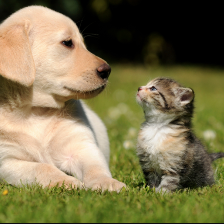

In [49]:
show(img)

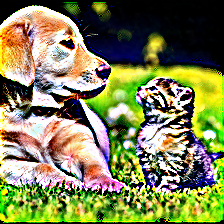

In [50]:
feature_inversion(img,'conv2d0')

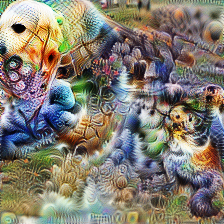

In [51]:
feature_inversion(img,'mixed5b')

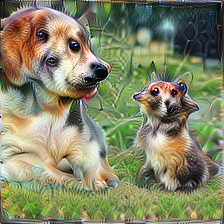

In [52]:
feature_inversion(img,'mixed4b')

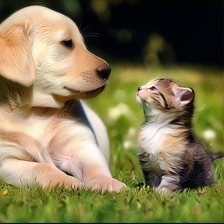

In [53]:
feature_inversion(img,'conv2d1')

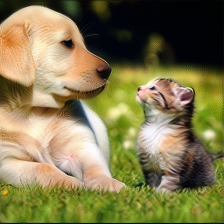

In [54]:
feature_inversion(img,'conv2d2')

Above we could see visualisations from different layers.The earlier layers('conv2d1,conv2d2') produce an image that almost resembles the input image,indicating the features are more invertible. As we go deeper through the mixed layers, we could see the network is reproducing image parts and also the reliance of color is apparent in the visualisations obtained in the mixed layers. The dog head with eyes is more pronounced in those visualisations indicating that's a promiment feature learned by the network.

In [55]:
#Exercise:

#Load the flowers image from given url and visualise conv2d2 and mixed5b layers.

img = load("https://storage.googleapis.com/lucid-static/building-blocks/examples/flowers.png")
## The image should be of shape (224,224)


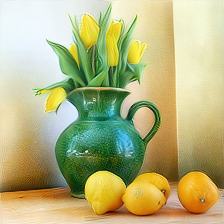

In [56]:
feature_inversion(img,'conv2d2')

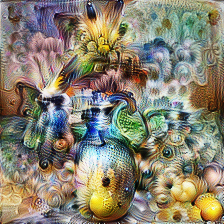

In [57]:
feature_inversion(img,'mixed5b')

## Conclusion

In this concept, we have learned to visualise the information contained in representation. Though it isn't fool proof,it's a useful way to verify what patterns are captured by the neural network.

## References:
    
   1. Distill article on feature visualisation https://distill.pub/2017/feature-visualization/
   2. Mahendran, Aravindh, and Andrea Vedaldi. "Understanding deep image representations by inverting them." Proceedings of the IEEE conference on computer vision and pattern recognition. 2015.

## Quiz:

1. Among the following pick the valid objectives that motivate visualisation of internal states in a neural network?


A .  Filter visualisation helps us  identify the locations of Sobel detector within the neural network.<br>
B .  Filter visualisation helps us identify if there are filters similar to Sobel within the network.<br
C .  Feature visualisations always helps us identify the patterns learned in each layer.<br>
D .  Feature visualisations are sometimes helpful in identifying the patterns learned in each layer but not always.<br>

1 . A and C  <br>
2 . B and D  <br>
3 . Only B   <br>
4 . Only D   <br>



Answer : 2 . 

2. Through  activation maximisation which among the below are valid choices for objective function?


1 . Activation of a single neuron.

2 . Activation of a channel in some layer.

3 . Activiations of an entire layer.

4 . All of the above


Answer: 4.

3. What do we infer by  visualisation techniques about the  the early layers?

1 . Early layers contain information about object parts.<br>
2 . Early layers contain information only about edges that make up object parts.<br>
3 . Early layers are mostly invertible,the original image can be identified .<br>
4 . Early layers are non-invertible and it's harder to identify the original image and after transformation.<br>

Answer:  3 

